In [1]:
%%html
<style>
    @font-face {
        font-family: "Computer Modern";
        src: url('http://mirrors.ctan.org/fonts/cm-unicode/fonts/otf/cmunss.otf');
    }
    @font-face {
        font-family: "Computer Modern";
        src: url('http://mirrors.ctan.org/fonts/cm-unicode/fonts/otf/cmunsx.otf');
        font-weight: bold;
    }
    @font-face {
        font-family: "Computer Modern";
        src: url('http://mirrors.ctan.org/fonts/cm-unicode/fonts/otf/cmunsi.otf');
        font-style: italic, oblique;
    }
    @font-face {
        font-family: "Computer Modern";
        src: url('http://mirrors.ctan.org/fonts/cm-unicode/fonts/otf/cmunbxo.otf');
        font-weight: bold;
        font-style: italic, oblique;
    }
    .text_cell { font-family: "Computer Modern", "Palatino", "Palatino Linotype", serif; }
    .code_cell:first-child { display: none; } 
    h1, h2, h3, h4 { text-align: center; }
</style>

# Chaotic Behavior of the Triple Pendulum
## A Computational Approach

### PART II

#### Rachel Bass and Cory McCartan

In [3]:
%%capture

# Set-up and formatting

%pylab inline
from scipy.integrate import odeint 
import scipy.signal as signal
# picture configuration
matplotlib.rcParams["savefig.dpi"] = 300
matplotlib.rcParams["savefig.bbox"] = "tight"

from IPython.core.interactiveshell import InteractiveShell
%config InlineBackend.figure_format = "retina"  # higher-def plots

## Setup (again)

Copying over necessary functions from part I.

In [6]:
# Constants
g = 9.8 # m/s^2
l = 0.5 # m

# Mechanics of triple pendulum system.
# Passed into odeint function.
def triple_pendulum(r, t, g, l):
    phi_1, phi_2, phi_3, dphi_1, dphi_2, dphi_3 = r # unpack variables
    
    # precalculate trig functions
    cos_1_2 = cos(phi_1 - phi_2)
    cos_1_3 = cos(phi_1 - phi_3)
    cos_2_3 = cos(phi_2 - phi_3)
    sin_1_2 = sin(phi_1 - phi_2)
    sin_1_3 = sin(phi_1 - phi_3)
    sin_2_3 = sin(phi_2 - phi_3)
    
    # define arrays and vectors
    A = array([[3,         2*cos_1_2, cos_1_3],
               [2*cos_1_2, 2,         cos_2_3],
               [cos_1_3,   cos_2_3,   1      ]])
    
    B = array([-dphi_3**2 * sin_1_3 - 2*dphi_2**2 * sin_1_2 - 3*g*sin(phi_1)/l,
               -dphi_3**2 * sin_2_3 + 2*dphi_1**2 * sin_1_2 - 2*g*sin(phi_2)/l,
                dphi_2**2 * sin_2_3 +   dphi_1**2 * sin_1_3 -   g*sin(phi_3)/l])
    
    ddphi =  matmul(inv(A), B) # angular acceleration
    return concatenate(([dphi_1, dphi_2, dphi_3], ddphi)) # tack on angular velocity

def solve_triple_pendulum(r0, tmax, l=l, dt = 0.001):
    t = arange(0, tmax, dt)
    solution = odeint(triple_pendulum, r0, t, args = (g, l))
    
    
    phi_1 = solution[:, 0]
    phi_2 = solution[:, 1]
    phi_3 = solution[:, 2]
    
    dphi_1 = solution[:, 3]
    dphi_2 = solution[:, 4]
    dphi_3 = solution[:, 5]
    
    return t, phi_1, phi_2, phi_3, dphi_1, dphi_2, dphi_3

# Plots phi_1, phi_2, and phi_3 over time.
def time_plot(solution, subtitle = ""):
    t, phi_1, phi_2, phi_3, dphi_1, dphi_2, dphi_3 = solution
    
    deg_1 = phi_1 * 180 / pi
    deg_2 = phi_2 * 180 / pi
    deg_3 = phi_3 * 180 / pi
    
   
    figsize(15, 7)
    fig = figure()
          
    plot(t, deg_1, "-g", label="First pendulum")
    plot(t, deg_2, "--m", label="Second pendulum")
    plot(t, deg_3, ":k", label="Third pendulum")
    # titles and labels
    title("Pendulum Angles over Time\n{}".format(subtitle))
    xlabel("Time (s)")
    ylabel("Angle (deg)")
    # legend
    legend()
    
    return fig
    
    
# Plots the pendulum trajectory in x-y space. NOT scaled appropriately to length l
def trajectory_plot(solution, subtitle = ""):
    t, phi_1, phi_2, phi_3, dphi_1, dphi_2, dphi_3 = solution
    
    x1 = sin(phi_1)
    x2 = x1 + sin(phi_2)
    x3 = x2 + sin(phi_3)
    y1 = -cos(phi_1)
    y2 = y1 - cos(phi_2)
    y3 = y2 - cos(phi_3)
    
    figsize(15, 7)
    fig = figure()
    
    axvline(x = 0, color = "#bbbbbb")#vertical light gray line
    axhline(y = 0, color = "#bbbbbb")#horizontal light gray line
    
    plot(x1, y1, "-g", label = "First Pendulum")
    plot(x2, y2, "--m", label = "Second Pendulum")
    plot(x3, y3, ":k", label = "Third Pendulum")
    
    title("Pendulum Trajectories over Time\n{}".format(subtitle))
    xlabel("x / l")
    ylabel("y / l")
    legend()
    
    margins(y = 0.1)
    
    return fig
    
# Plots the phase space trajectories of the masses
def phase_space_plot(solution, subtitle = ""):
    t, phi_1, phi_2, phi_3, dphi_1, dphi_2, dphi_3 = solution
    
    fig = figure()
    title("Phase Space Trajectories of Masses\n{}\n\n".format(subtitle))
    axis("off")
    
    plot1 = fig.add_subplot(131)
    axvline(x = 0, color = "#bbbbbb")# vertical light gray line
    axhline(y = 0, color = "#bbbbbb")# horizontal light gray line
    plot(phi_1, dphi_1, "k")
    title("First Pendulum")
    xlabel("Angle")
    ylabel("Angular Velocity (1/s)")
    
    plot2 = fig.add_subplot(132)
    axvline(x = 0, color = "#bbbbbb")# vertical light gray line
    axhline(y = 0, color = "#bbbbbb")# horizontal light gray line
    plot(phi_2, dphi_2, "k")
    title("Second Pendulum")
    xlabel("Angle")
    
    plot3 = fig.add_subplot(133)
    axvline(x = 0, color = "#bbbbbb")# vertical light gray line
    axhline(y = 0, color = "#bbbbbb")# horizontal light gray line
    plot(phi_3, dphi_3, "k")
    title("Third Pendulum")
    xlabel("Angle")
    
    tight_layout()
    
    return fig

def frequency_plot(solution, max_freq = 2):
    t, phi_1, phi_2, phi_3, _, _, _ = solution
    
    # take the Fourier transforms
    fft_1 = fft.rfft(phi_1)
    fft_2 = fft.rfft(phi_2)
    fft_3 = fft.rfft(phi_3)

    # calculate our time step and use it to scale our frequency axis
    dt = t[1] - t[0]
    freqs = fft.rfftfreq(len(phi_1), dt)

    # fft returns complex numbers, and so we take the absolute value of each
    figsize(15, 7)
    fig = figure()
    plot(freqs, absolute(fft_1), "-g", label = "First Pendulum")
    plot(freqs, absolute(fft_2), "--m", label = "Second Pendulum")
    plot(freqs, absolute(fft_3), ":k", label = "Third Pendulum")

    title("Fourier Transform of Pendulum Angles")
    xlabel("Frequency (1/s)")
    ylabel("Angle")

    xlim(0, max_freq) # we don't care about high frequencies
    legend()
    
    return fig

# Generate data for contour plot
# params: the index (or indices) of the parameter in the r0 vector which to plot over. 
#   For example, to simulate changing the initial angle of the 2nd pendulum from 0 to pi radians, we would call 
#   contour_data(1, 0, pi, ...) since phi_2 is stored in index 1 of the r0 vector
# start: the starting value of the parameter
# end: the ending value of the parameter
# xSize: the number of intermediate paramter values. Will be the x-resolution
# ySize: the number of frequencies between 0 and max_freq. Will be the y-resolution
# fft_param: which parameter to perform the FFT on and to plot. Defaults to phi_3
# max_freq: Maximum frequency to save. Defaults to 2 1/s
# file: name of the file to save the data to.  All data will be saved to the data/ folder
def contour_data(params, start, end, xSize, ySize, fft_param = 3, max_freq = 2, file="contour"):
    initial_values = linspace(start, end, xSize)
    
    t_max = ySize / max_freq


    data = zeros((xSize, ySize))

    for step, p_0 in enumerate(initial_values):
        # set up initial conditions vector
        r0 = zeros(6)
        r0[params] = p_0
        # run simulation
        solution  = solve_triple_pendulum(r0, tmax=t_max, dt=0.05) 

        fft_data = absolute(fft.rfft(solution[fft_param]))[ : ySize] # get FFT and discard high frequencies
        # normalize to this solution's values, concatenate onto our results array
        data[step, :] = fft_data / max(fft_data) 
        
    save("data/{}.npy".format(file), data)
        
def plot_contour(data, start, end, max_freq = 2):
    # plot
    figsize(12,7)
    fig = figure()
    imshow(transpose(data), extent=[start, end, 0, max_freq], origin="lower", 
           interpolation="spline36", aspect=0.6*(end-start)/max_freq, cmap="plasma") # 0=white, 1=black
    ylabel("Frequency of Solution (1/s)")
    
    return fig

$$ $$

## Analysis

*(continued from Part I)*

This last contour plot is particularly striking, as there is a very sharp discontinuity as the system moves from the periodic to the chaotic regime. It looks like this occurs at around $\phi=1.35$, but we'd like to know the exact value.  We can calculate this numerically by extracting the peak value for each initial angle, and then finding where this peak value suddnely drops from around 0.45 to 0.

In [8]:
data_angles = load("data/contour_angles.npy")

# find peaks
peaks = [argmax(spectrum) for spectrum in data_angles]
d_peaks = diff(peaks) # find jump
drop_index = argmin(d_peaks)

# calculate angle from drop
critical_angle = (drop_index / len(data_angles)) * (3*pi/4)
critical_angle_degrees = critical_angle * 180 / pi
print("Critical angle: {:.1f}°".format(critical_angle_degrees))

Critical angle: 78.8°


Let's explore this critical angle further. Running the simulation for $\phi_1=\phi_2=\phi_3=78.8°$, we see that the motion is  periodic, but barely. Notice that the phase space plots are symmetrical.

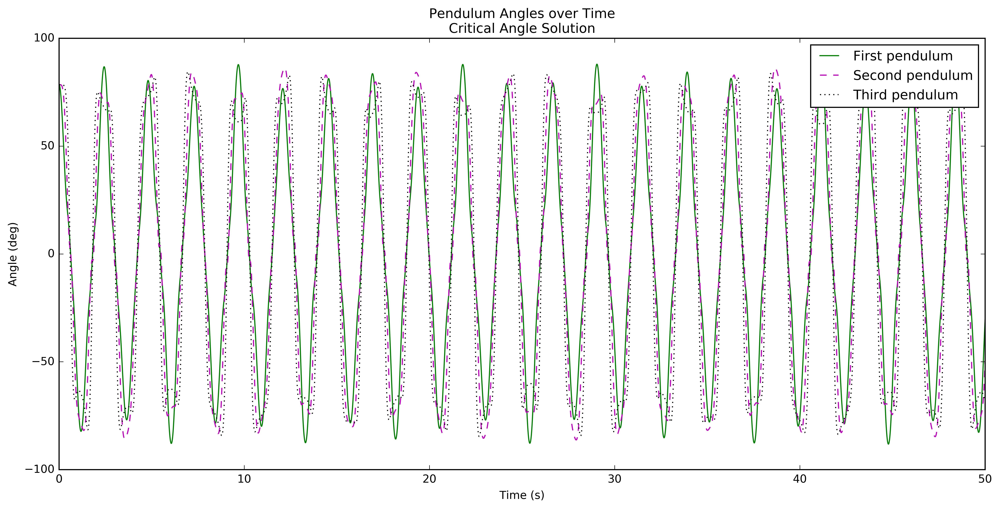

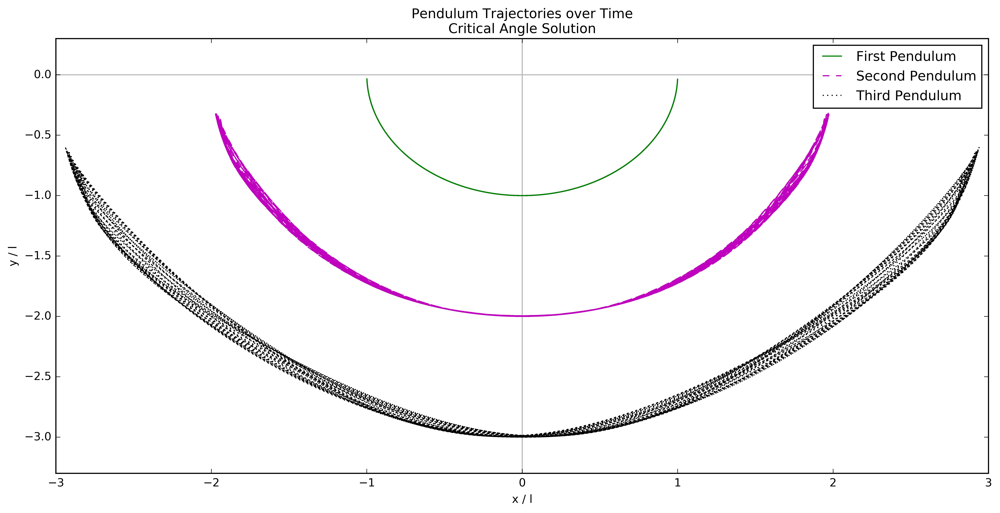

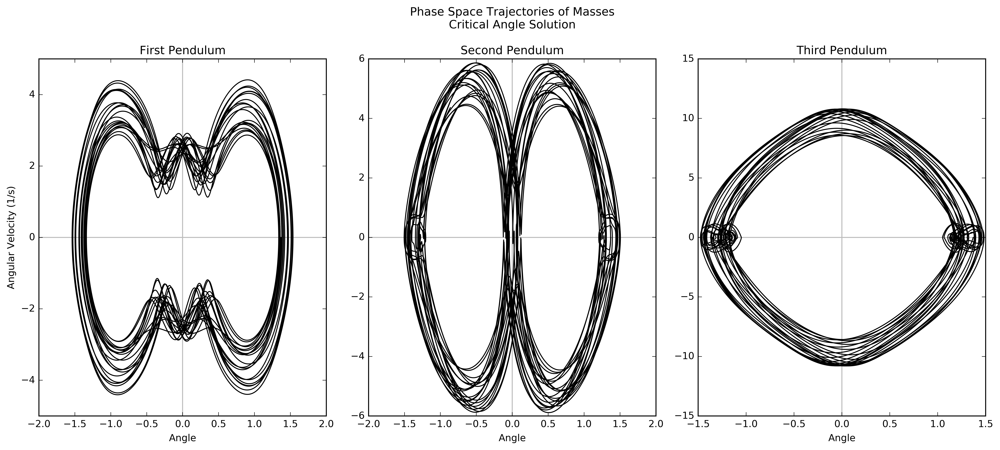

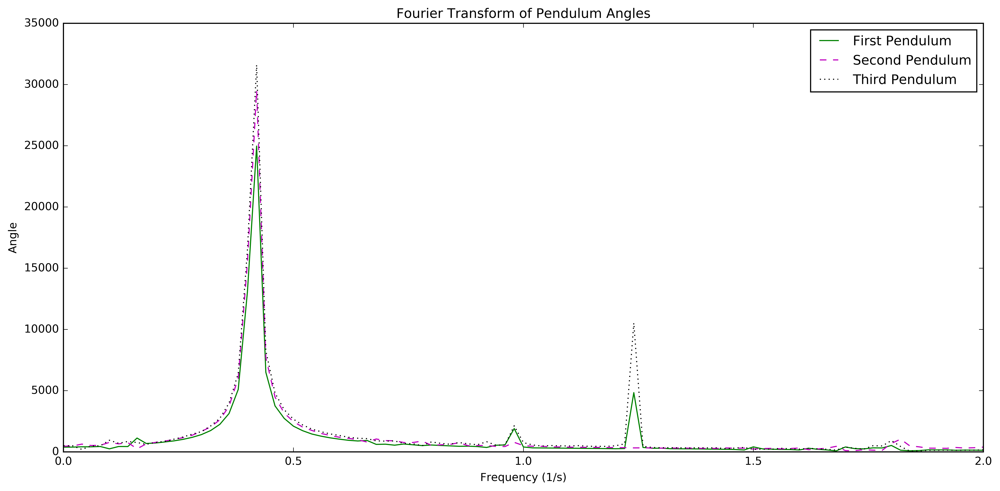

In [81]:
solution = solve_triple_pendulum([critical_angle, critical_angle, critical_angle, 0, 0, 0], tmax = 50)

time_plot(solution, "Critical Angle Solution").savefig("figures/critical_angle_time_sol.png")
trajectory_plot(solution, "Critical Angle Solution").savefig("figures/critical_angle_trajetory.png")
phase_space_plot(solution, "Critical Angle Solution").savefig("figures/critical_angle_phase_space.png")
frequency_plot(solution).savefig("figures/fft_critical.png");

Adding just 0.04 radians to the inital $\phi_1$, we get a chaotic solution. Now notice that the phase space plots are not symmetrical, and the Fourier plot has no strong peaks.

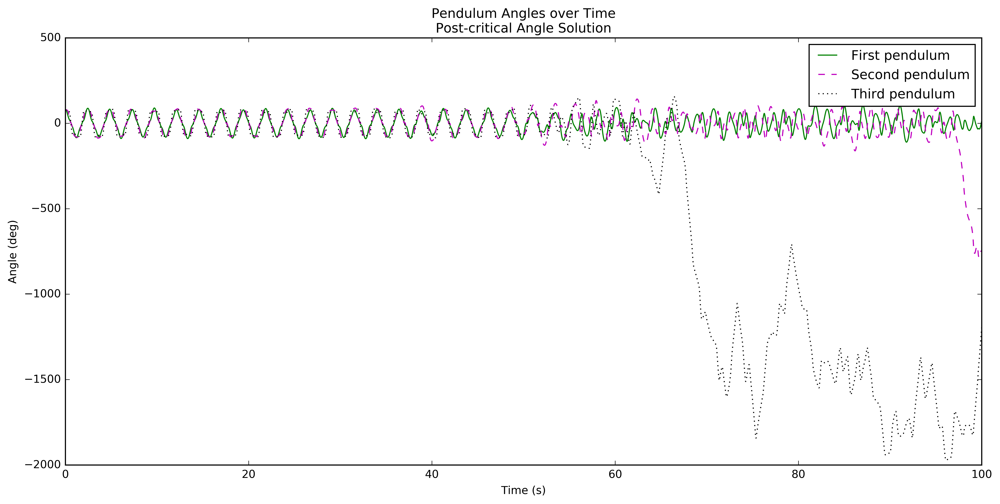

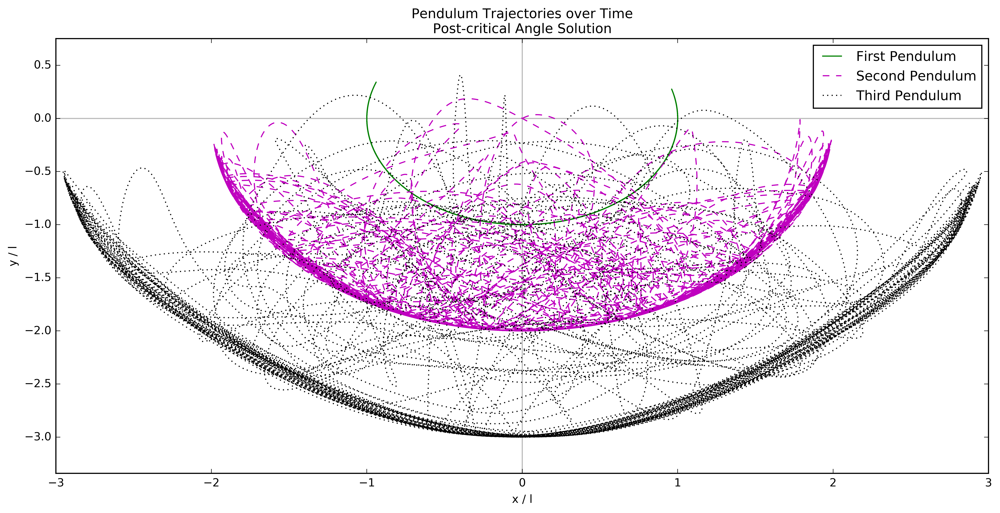

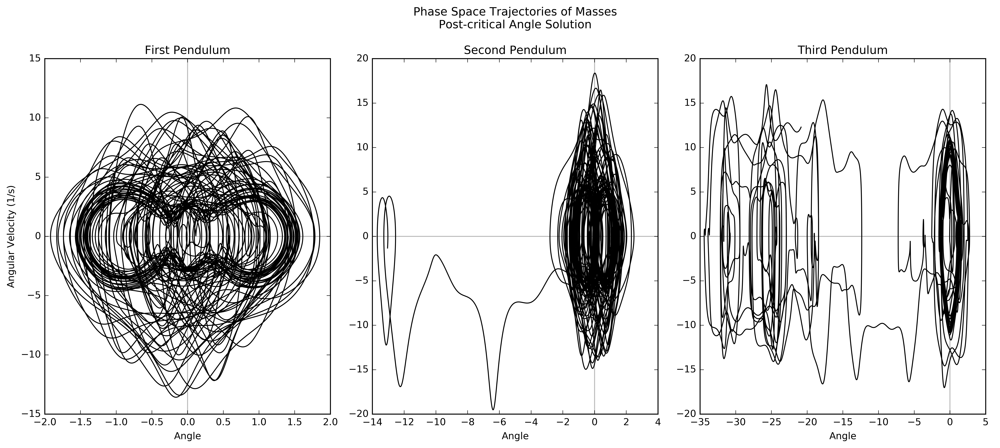

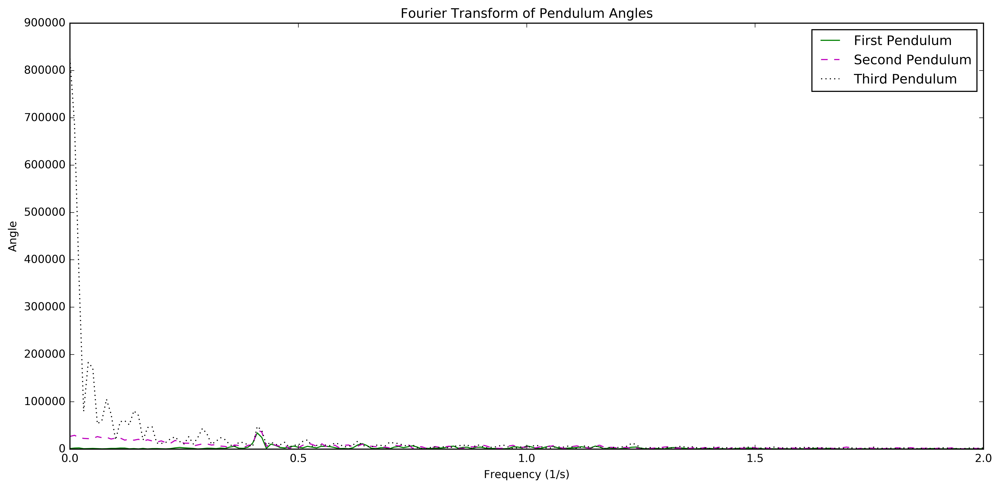

In [82]:
solution = solve_triple_pendulum([critical_angle + 0.04, critical_angle, critical_angle, 0, 0, 0], tmax = 100)

time_plot(solution, "Post-critical Angle Solution").savefig("figures/postcritical_angle_time_sol.png")
trajectory_plot(solution, "Post-critical Angle Solution").savefig("figures/postcritical_angle_trajectory.png")
phase_space_plot(solution, "Post-critical Angle Solution").savefig("figures/postcritical_angle_phase_space.png")
frequency_plot(solution).savefig("figures/fft_postcritical.png");

What causes this shift from periodicity to chaos? It's hard to know exactly, but notice that in the sub-critical case, the trajectory of $m_1$ never quite crosses the x-axis (though it gets close). In the post-critical case, however, the $m_1$ trajecory does cross the x-axis, and we have chaos.

We can study this further by examining how the maximum value of $\phi_1$ depends on the starting angle.

In [ ]:
steps = 600
initial_angles = linspace(pi/4, 3*pi/4, steps)
    
data_max = zeros(steps)

for index, angle in enumerate(initial_angles):
    # run simulation
    solution  = solve_triple_pendulum([angle, angle, angle, 0, 0, 0], tmax=40, dt=0.05) 

    data_max[index] = max(abs(solution[1])) # find maximum value of phi_1

save("data/max_angle.npy", data_max)

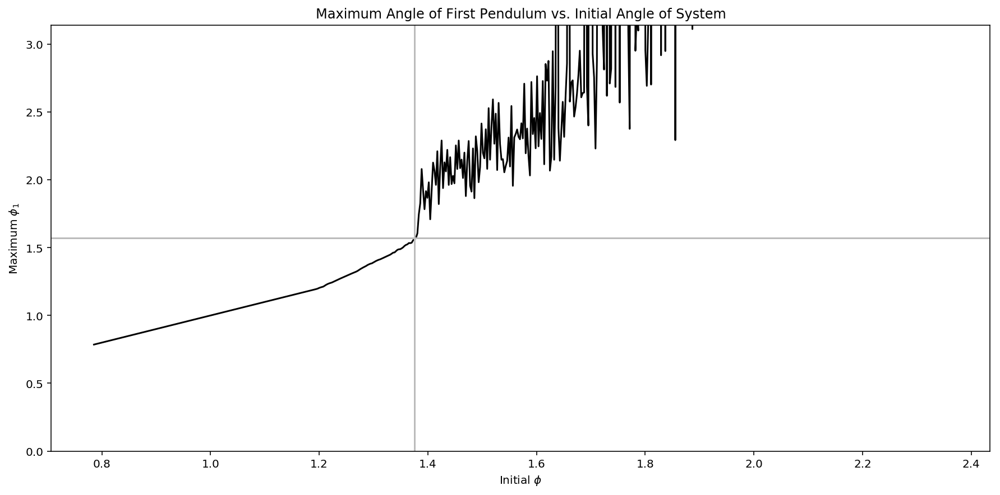

In [14]:
figsize(15, 7)
fig = figure()

plot(initial_angles, data_max, "k")

ylim(0, pi)
title("Maximum Angle of First Pendulum vs. Initial Angle of System")
xlabel("Initial $\\phi$")
ylabel("Maximum $\\phi_1$")

axhline(y = pi/2, color="#bbbbbb")
axvline(x = 1.375319, color="#bbbbbb")

fig.savefig("figures/max_angle_critical.png");

This plot tells us about one route to chaos--when all pendula have a shared initial angle less than the critical angle of 78.8 degrees (vertical line), the maximum angle of the first pendulum grows as the initial angle grows in an orderly fashion. After the initial angle passes the critical angle, the maximum angle of the first pendulum no longer grows with the initial angle. We see chaotic behavior occurs past the critical angle,as expected.